In [18]:
#####################################################################################
#This code includes a callable function that takes a GeoTiff format file, and returns
#pixel count of that file, the could percentage, and the shadow percentage.
#The workflow is
#1. take blue, green, red, and NearInfrared bands as b1,b2,b3,b4.
#2. get the max&min image.  The max image means every pixel takes the max value from b1 through b4 at that location.  
#3. apply a 7x7 max filter on max image, and a 7x7 min filter on min image.
#4. extract the cloud from min image, extract shadow(shadow plus water) from max image, land from NearInfrared.
#Arbitary threshold eas used for extracting cloud and shadows.
#5. get shadow by using land as a mask on shadow plus water image.
#6. count total pixels, cloud, shadow pixels and calculate cloud_perc and shadow_perc
########################################################################################

import gdal
import numpy as np
from scipy import ndimage
import sys
import os
import copy
import csv

def Cloud_Shadow_Stats(in_name, cloud_thresh=2000, shadow_thresh=1000):
    #1 open the tif, take 4 bands, and read them as arrays
    in_ds = gdal.Open(in_name)
    b1 = in_ds.GetRasterBand(1)
    b2 = in_ds.GetRasterBand(2)
    b3 = in_ds.GetRasterBand(3)
    b4 = in_ds.GetRasterBand(4)

    b1_array = b1.ReadAsArray()
    b2_array = b2.ReadAsArray()
    b3_array = b3.ReadAsArray()
    b4_array = b4.ReadAsArray()

    #2. make max image and min image.
    #np.dstack() takes a list of bands and makes a band stack
    #np.amax() find the max along the axis, here 2 means the axis that penetrates through bands in each pixel.
    band_list = [b1_array,b2_array,b3_array,b4_array]
    stacked = np.dstack(band_list)
    max_img = np.amax(stacked,2)
    min_img = np.amin(stacked,2)

    del b1_array, b2_array, b3_array, band_list

    #3. make max 7x7 filtered max and min image
    max7x7_img = ndimage.maximum_filter(max_img, 7)
    min7x7_img = ndimage.minimum_filter(min_img, 7)

    del max_img, min_img

    #4. extract cloud, shadow&water, land
    #The threshold here is based on Sitian and Tammy's test on 11 planet scenes.  It may not welly work for every AOI.
    #Apparently np.where() method will change or lost the datatype, so .astype(np.int16) is used to make sure the datatype is the same as original
    cloud_array = np.where(min7x7_img > cloud_thresh, 1, 0).astype(np.int16)
    shadow_and_water_array = np.where(max7x7_img < 1500, 1, 0).astype(np.int16)
    land_array = np.where(b4_array > shadow_thresh, 1, 0).astype(np.int16)

    del max7x7_img, min7x7_img, b4_array

    #5. get shadow by masking 
    shadow_array = np.where(land_array == 1, shadow_and_water_array, 0).astype(np.int16)

    #6. Calculate Statistics
    grid_count = np.ma.count(shadow_array)# acutally count all pixels 
    cloud_count = np.count_nonzero(cloud_array ==1)
    shadow_count = np.count_nonzero(shadow_array ==1)

    cloud_perc = cloud_count/grid_count
    shadow_perc = shadow_count/grid_count
    #print("The total number of pixel in the grid is {}, the cloud perc is :{}, the shadow perc is {}".format(grid_count, cloud_perc, shadow_perc))

    del cloud_array, shadow_and_water_array, land_array, shadow_array
    return [cloud_perc, shadow_perc]

PLANET_DIR = "/home/rave/tana-crunch/waves/cropmask/data/planet-za/"

#1. List dir and extract filename contains "SR"(surface reflectance)
file_names = os.listdir(PLANET_DIR)
tifs = [fn for fn in file_names if "SR" in fn if ".tif" in fn]

stat_list = []
for tif in tifs:
    stat_list.extend(Cloud_Shadow_Stats(os.path.join(PLANET_DIR,tif)))

Display Cloud and Shadow masks on top of images with clouds and visualiza images with clouds that don't have clouds or shadows identified

<IPython.core.display.Javascript object>


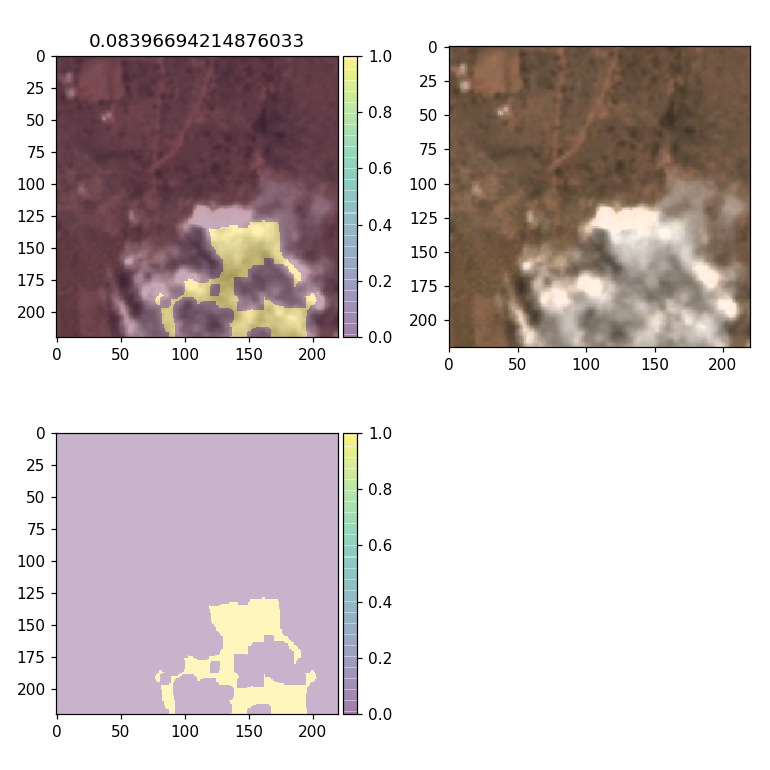

/opt/anaconda3/lib/python3.6/site-packages/skimage/io/_plugins/matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and
/opt/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)
/opt/anaconda3/lib/python3.6/site-packages/skimage/io/_plugins/matplotlib_plugin.py:74: UserWarning: Low image data range; displaying image with stretched contrast.
  warn("Low image data range; displaying image with "


<IPython.core.display.Javascript object>


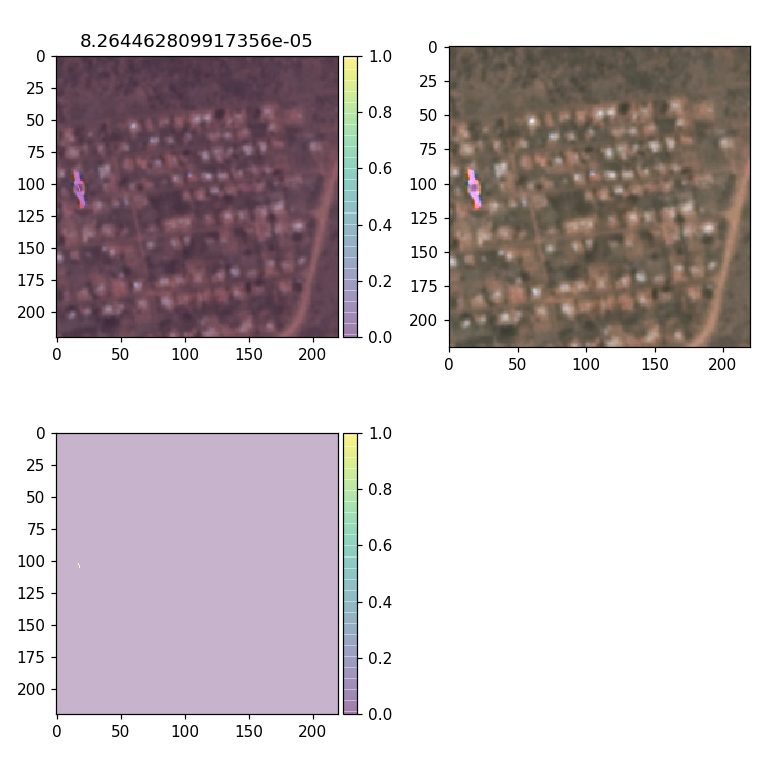

<IPython.core.display.Javascript object>


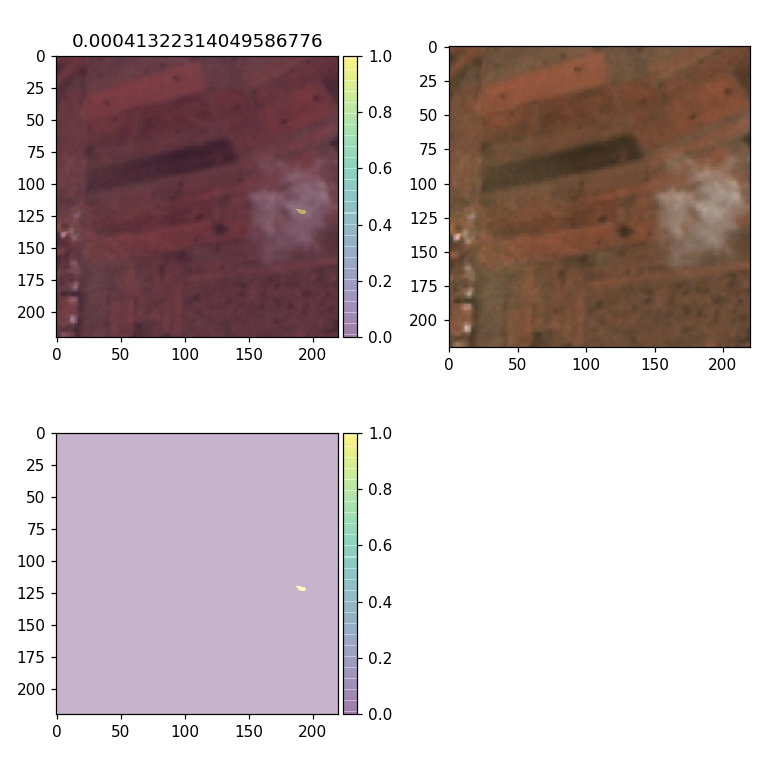

<IPython.core.display.Javascript object>


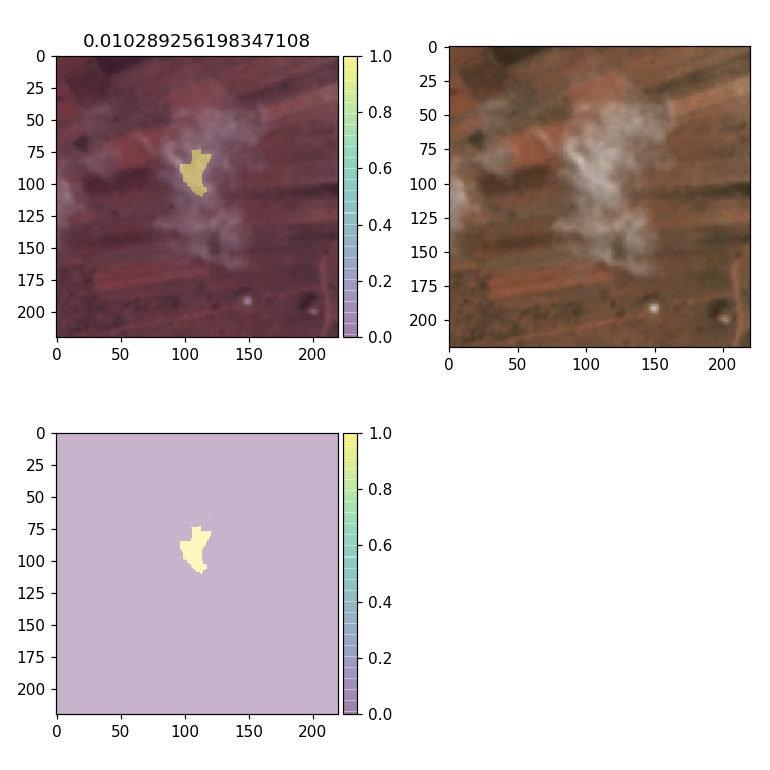

<IPython.core.display.Javascript object>


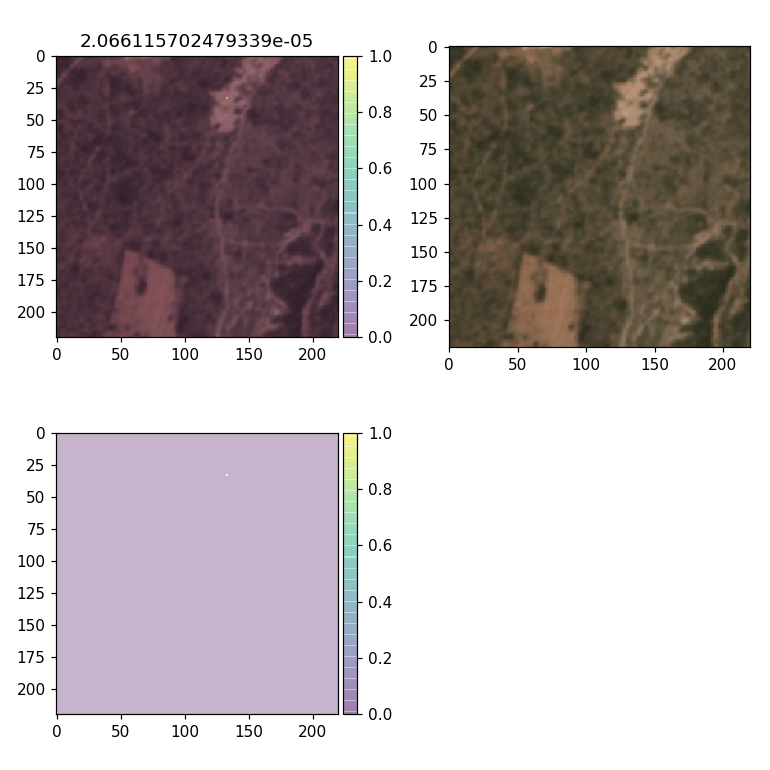

<IPython.core.display.Javascript object>


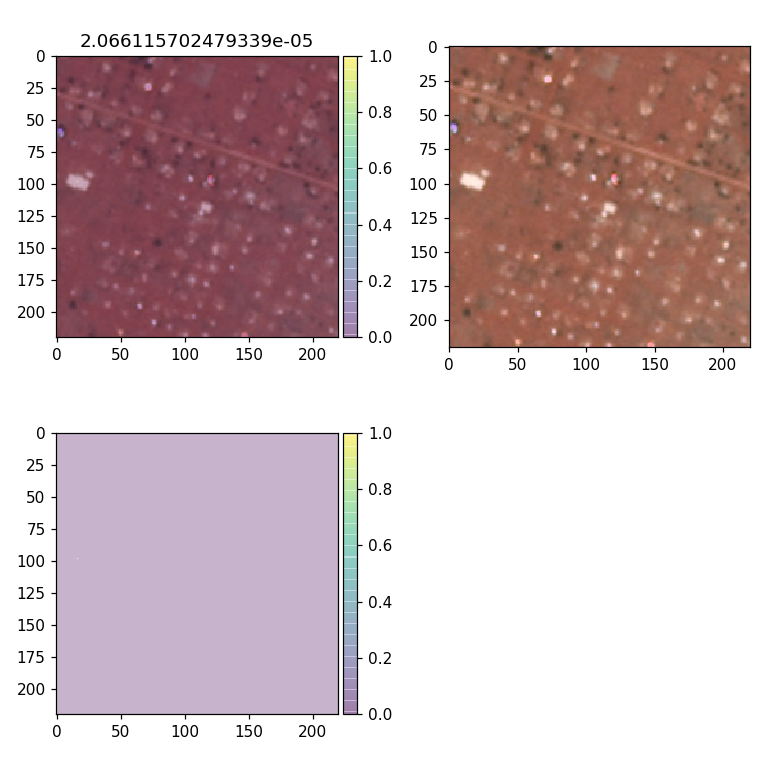

<IPython.core.display.Javascript object>


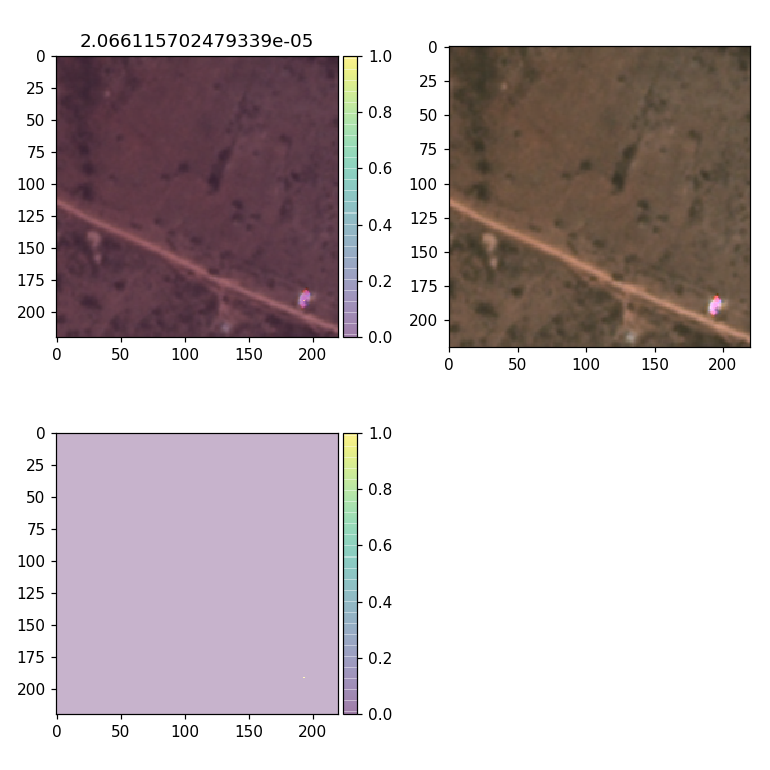

In [19]:
import numpy as np
import matplotlib.pyplot as plt
import skimage.io as skio
from skimage import exposure
%matplotlib notebook

def make_pretty(arr):
    normalize = lambda x: x / x.max()
    arr = skio.imread(os.path.join(PLANET_DIR, tif))
    arr_norm = np.apply_along_axis(normalize,2, arr)
    arr_norm = np.dstack([arr_norm[:,:,2],arr_norm[:,:,1], arr_norm[:,:,0]])
    return arr_norm
    
PLANET_DIR = "/home/rave/tana-crunch/waves/cropmask/data/planet-za/"

#1. List dir and extract filename contains "SR"(surface reflectance)
file_names = os.listdir(PLANET_DIR)
tifs = [fn for fn in file_names if "SR" in fn if ".tif" in fn]

for tif in tifs:
    f = os.path.join(PLANET_DIR,tif)
    cloud_perc = Cloud_Shadow_Stats(f, cloud_thresh=2000, shadow_thresh=1000)[0]
    
    if cloud_perc > 0:
        
        arr = skio.imread(f)
        min_img = np.amin(arr,2)
        min7x7_img = ndimage.minimum_filter(min_img, 7)
        cloud_array = np.where(min7x7_img > 2000, 1, 0).astype(np.int16)
        arr = make_pretty(arr)
        
        fig = plt.figure(figsize=(7,7))
        ax1 = plt.subplot(2, 2, 1)
        ax1.set_title(cloud_perc)
        skio.imshow(arr, cmap="brg")
        skio.imshow(cloud_array, alpha=.3)
        
        plt.subplot(2, 2, 2)
        skio.imshow(arr, cmap="brg")
        
        plt.subplot(2, 2, 3)
        skio.imshow(cloud_array, alpha=.3)

/opt/anaconda3/lib/python3.6/site-packages/skimage/io/_plugins/matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and
/opt/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)
/opt/anaconda3/lib/python3.6/site-packages/skimage/io/_plugins/matplotlib_plugin.py:74: UserWarning: Low image data range; displaying image with stretched contrast.
  warn("Low image data range; displaying image with "
/opt/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may cons

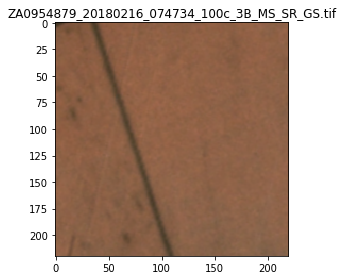

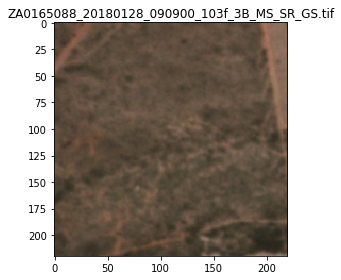

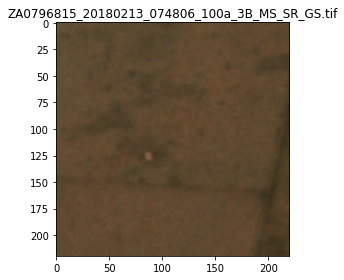

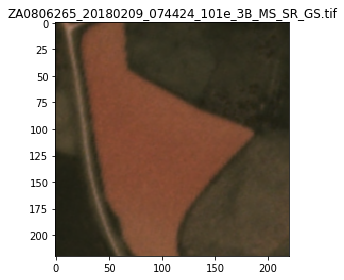

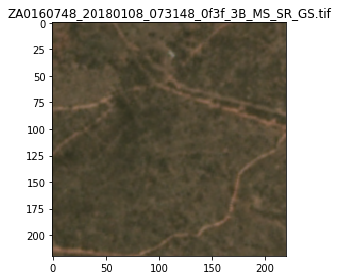

...

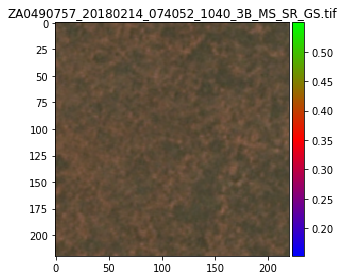

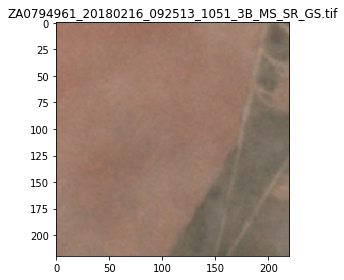

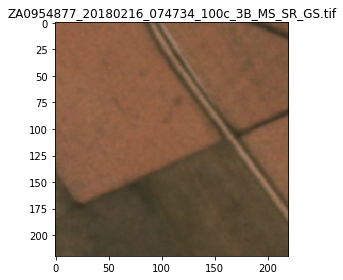

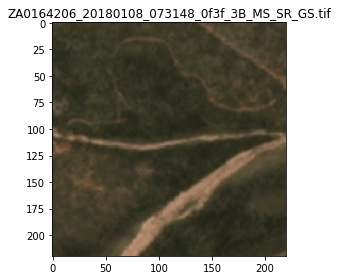

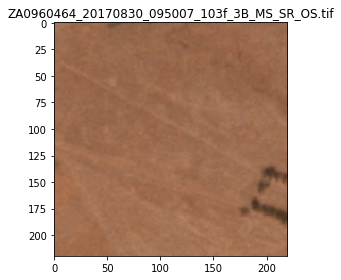

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def make_pretty(arr):
    normalize = lambda x: x / x.max()
    arr = skio.imread(os.path.join(PLANET_DIR, tif))
    arr_norm = np.apply_along_axis(normalize,2, arr)
    arr_norm = np.dstack([arr_norm[:,:,2],arr_norm[:,:,1], arr_norm[:,:,0]])
    return arr_norm
    
PLANET_DIR = "/home/rave/tana-crunch/waves/cropmask/data/planet-za/"

#1. List dir and extract filename contains "SR"(surface reflectance)
file_names = listdir(PLANET_DIR)
tifs = [fn for fn in file_names if "SR" in fn if ".tif" in fn]

for tif in tifs:
    f = os.path.join(PLANET_DIR,tif)
    arr = skio.imread(f)
    arr = make_pretty(arr)
    plt.figure()
    plt.title(tif)
    skio.imshow(arr, cmap="brg")

In [ ]:
#3. Write cloud shadow perc into csv file.
with open(r"D:\Extracting_Clouds\C2000_S1500_OS.csv", "w") as csvfile:
    headers = ["file_name", "cloud_perc", "shadow_perc"]
    
    writer = csv.writer(csvfile, lineterminator='\n')
    writer.writerow(headers)
    for val in cs_list:
        writer.writerow(val)

['ZA0954879_20180216_074734_100c_3B_MS_SR_GS.tif',
 'ZA0165088_20180128_090900_103f_3B_MS_SR_GS.tif',
 'ZA0796815_20180213_074806_100a_3B_MS_SR_GS.tif',
 'ZA0806265_20180209_074424_101e_3B_MS_SR_GS.tif',
 'ZA0160748_20180108_073148_0f3f_3B_MS_SR_GS.tif',
 'ZA0494727_20180217_073944_102f_3B_MS_SR_GS.tif',
 'ZA0800512_20170830_095013_103f_3B_MS_SR_OS.tif',
 'ZA0564350_20180215_072743_0f34_3B_MS_SR_GS.tif',
 'ZA0489758_20180206_073324_0f34_3B_MS_SR_GS.tif',
 'ZA0491080_20180206_073324_0f34_3B_MS_SR_GS.tif',
 'ZA0485821_20180210_073348_1006_3B_MS_SR_GS.tif',
 'ZA0484201_20180217_073944_102f_3B_MS_SR_GS.tif',
 'ZA0484195_20180210_091735_104e_3B_MS_SR_GS.tif',
 'ZA0116367_20170820_072302_1036_3B_MS_SR_OS.tif',
 'ZA0964178_20180216_074734_100c_3B_MS_SR_GS.tif',
 'ZA0964181_20170829_074044_1027_3B_MS_SR_OS.tif',
 'ZA0956736_20170829_074043_1027_3B_MS_SR_OS.tif',
 'ZA0808103_20170823_094724_0f46_3B_MS_SR_OS.tif',
 'ZA0561486_20170816_071951_1031_3B_MS_SR_OS.tif',
 'ZA0483207_20180212_073537_0e0